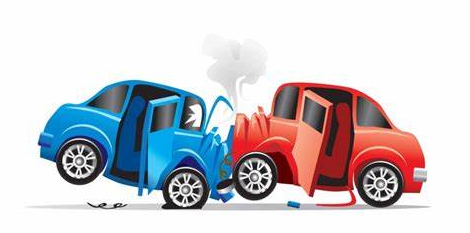

In [1]:
# Análise de dados de acidentes de trânsito em Porto Alegre
# by geanclm on 01/05/2023 at 10h

In [2]:
# Importar biblioteca necessária para a exploração dos dados em dataframe
import pandas as pd

# para a geração do preview dos mapas reais com as localidades lat e lon
import folium
from folium.plugins import HeatMap
from folium.plugins import MarkerCluster

# Observação: caso a biblioteca folium não esteja instalada
# a biblioteca o comando abaixo deve ser utilizado
# !pip install folium

# para a geração de gráficos
import matplotlib.pyplot as plt

<center style="font-size:18pt; background-color:#0f79b6">
    <br/>
        <b style="color: #ffffff">
            Fonte de dados
        </b>
    <br/>&nbsp;
</center>

[Dados Abertos POA](https://dadosabertos.poa.br/dataset/acidentes-de-transito-acidentes/resource/b56f8123-716a-4893-9348-23945f1ea1b9)

In [3]:
# dados do arquivo csv com dados separados por ponto e vírgula
df = pd.read_csv('cat_acidentes.csv', sep = ';')

<center style="font-size:18pt; background-color:#0f79b6">
    <br/>
        <b style="color: #ffffff">
            Análise dos dados
        </b>
    <br/>&nbsp;
</center>

In [4]:
df

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
0,2023-04-01 01:33:47,0.0,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000,0.000000,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
1,2023-04-01 01:33:47,170.0,0.0,2018-01-01 00:00:00,1,0,0,0,0,1,...,-51.214455,-30.122420,R CASEMIRO DE SOUZA,NaN,ATROPELAMENTO,SEGUNDA-FEIRA,00:30:00.0000000,NOITE,SUL,NaN
2,2023-04-01 01:33:47,2617.0,0.0,2018-01-01 00:00:00,0,0,0,0,0,1,...,-51.203106,-30.073318,AV PROF OSCAR PEREIRA,NaN,COLISÃO,SEGUNDA-FEIRA,07:55:00.0000000,DIA,SUL,NaN
3,2023-04-01 01:33:47,1590.0,0.0,2018-01-01 00:00:00,1,0,0,0,0,1,...,-51.134118,-30.229493,AV BOA VISTA,NaN,CHOQUE,SEGUNDA-FEIRA,20:18:00.0000000,NOITE,SUL,NaN
4,2023-04-01 01:33:47,0.0,0.0,2018-01-01 00:00:00,1,0,0,0,0,1,...,NaN,NaN,AV BOA VISTA,NaN,CHOQUE,SEGUNDA-FEIRA,11:00:00.0000000,DIA,SUL,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64412,2023-04-01 01:33:47,1272.0,0.0,2023-03-25 00:00:00,0,0,0,0,0,2,...,-51.171809,-30.051105,R PROF CRISTIANO FISCHER,R PROF PEDRO SANTA HELENA,TOMBAMENTO,SÁBADO,09:45:00.0000000,DIA,LESTE,NaN
64413,2023-04-01 01:33:47,305.0,0.0,2023-03-28 00:00:00,0,0,0,0,0,2,...,-51.234955,-30.029907,TRAV ARAUJO RIBEIRO,NaN,CHOQUE,TERÇA-FEIRA,15:15:00.0000000,DIA,CENTRO,NaN
64414,2023-04-01 01:33:47,3650.0,0.0,2023-03-29 00:00:00,0,0,0,0,0,2,...,-51.194909,-30.050311,AV IPIRANGA,R LA PLATA,ABALROAMENTO,QUARTA-FEIRA,07:20:00.0000000,DIA,LESTE,NaN
64415,2023-04-01 01:33:47,16.0,0.0,2023-03-30 00:00:00,0,0,0,0,0,1,...,-51.227514,-30.030739,AV SENADOR SALGADO FILHO,NaN,ABALROAMENTO,QUINTA-FEIRA,08:15:00.0000000,DIA,CENTRO,MAIS (LOTE 6)


In [5]:
# a base apresenta muitos campos e nesse momento a atenção será dada para as coordenadas geográficas
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64417 entries, 0 to 64416
Data columns (total 34 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   data_extracao  64417 non-null  object 
 1   predial1       62884 non-null  float64
 2   queda_arr      64417 non-null  float64
 3   data           64417 non-null  object 
 4   feridos        64417 non-null  int64  
 5   feridos_gr     64417 non-null  int64  
 6   mortes         64417 non-null  int64  
 7   morte_post     64417 non-null  int64  
 8   fatais         64417 non-null  int64  
 9   auto           64417 non-null  int64  
 10  taxi           64417 non-null  int64  
 11  lotacao        64417 non-null  int64  
 12  onibus_urb     64417 non-null  int64  
 13  onibus_met     64417 non-null  int64  
 14  onibus_int     64417 non-null  int64  
 15  caminhao       64417 non-null  int64  
 16  moto           64417 non-null  int64  
 17  carroca        64417 non-null  int64  
 18  bicicl

In [6]:
# deletar valores faltantes apenas nas colunas indicadas pelo subset
df = df.dropna(subset=['latitude', 'longitude'], how='any')

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 53840 entries, 0 to 64416
Data columns (total 34 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   data_extracao  53840 non-null  object 
 1   predial1       52615 non-null  float64
 2   queda_arr      53840 non-null  float64
 3   data           53840 non-null  object 
 4   feridos        53840 non-null  int64  
 5   feridos_gr     53840 non-null  int64  
 6   mortes         53840 non-null  int64  
 7   morte_post     53840 non-null  int64  
 8   fatais         53840 non-null  int64  
 9   auto           53840 non-null  int64  
 10  taxi           53840 non-null  int64  
 11  lotacao        53840 non-null  int64  
 12  onibus_urb     53840 non-null  int64  
 13  onibus_met     53840 non-null  int64  
 14  onibus_int     53840 non-null  int64  
 15  caminhao       53840 non-null  int64  
 16  moto           53840 non-null  int64  
 17  carroca        53840 non-null  int64  
 18  bicicl

In [8]:
mapa = folium.Map(location=[-30.1, -51.15], zoom_start=11)
coordenadas = list(zip(df.latitude, df.longitude))
mapa_calor = HeatMap(coordenadas, radius=9, blur=10)
mapa.add_child(mapa_calor)
mapa

In [9]:
mapa = folium.Map(location=[-30.1, -51.15], zoom_start=11)
mapa_cluster = MarkerCluster(coordenadas)
mapa.add_child(mapa_cluster)
mapa

In [10]:
df['data']

0        2020-10-17 00:00:00
1        2018-01-01 00:00:00
2        2018-01-01 00:00:00
3        2018-01-01 00:00:00
5        2018-01-02 00:00:00
                ...         
64412    2023-03-25 00:00:00
64413    2023-03-28 00:00:00
64414    2023-03-29 00:00:00
64415    2023-03-30 00:00:00
64416    2023-03-30 00:00:00
Name: data, Length: 53840, dtype: object

In [11]:
df['data'] = pd.to_datetime(df['data'], errors='coerce')
df_ano = df['data'].dt.year.value_counts()

<ipython-input-11-3fe722c5ed27>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['data'] = pd.to_datetime(df['data'], errors='coerce')


In [12]:
# inserção de datas equivocadas
df_ano = df_ano.drop(2026) # ano digitado de forma equivocada!
df_ano = df_ano.drop(2202) # ano digitado de forma equivocada!
df_ano = df_ano.drop(2043) # ainda não chegamos nesse ano!

In [13]:
df_ano

2022.0    13312
2019.0    12444
2021.0    11699
2018.0    10319
2023.0     3166
2020.0     2894
Name: data, dtype: int64

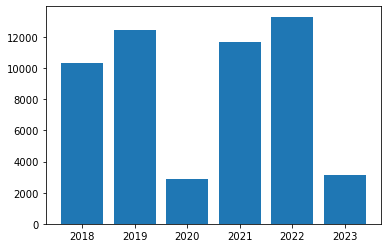

In [14]:
plt.bar(df_ano.index, df_ano.values)
plt.show()

In [15]:
# Percebe-se uma forte tendência do aumento de número de acidentes na região
# de 2018 para 2019 percebe-se um aumento
# de 2021 para 2022 percebe-se um aumento
# de 2020 para Jan-Mai/2023 já é perceptível um pequeno aumento

In [16]:
df_ano

2022.0    13312
2019.0    12444
2021.0    11699
2018.0    10319
2023.0     3166
2020.0     2894
Name: data, dtype: int64

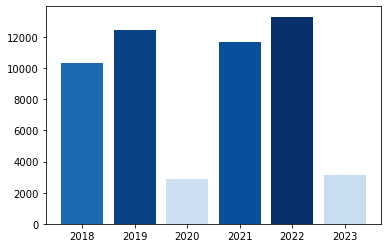

In [17]:
gradiente = df_ano/df_ano.max()
cores = plt.cm.Blues(gradiente)
plt.bar(df_ano.index, df_ano.values, color=cores)
plt.show()

In [18]:
# total de fatalidades, durante o dia, considerando todo o período da base de dados analisado
df['noite_dia'].loc[(df['noite_dia']=='DIA') & (df['mortes'] == 1)].count()

64

<center style="font-size:18pt; background-color:#0f79b6">
    <br/>
        <b style="color: #ffffff">
            Insights
        </b>
    <br/>&nbsp;
</center>

In [19]:
# 1 - Ausêcnia de dados na base;
# 2 - Dados inseridos na base com erros ou ausência de dados;
# 3 - Após a pandemia, ano principal de 2020, o número de acidentes continuou crescendo em 2021;
# 4 - Percebe-se um crescimento recorrente no números de acidentes de trânsito no ano de 2023;

<center style="font-size:18pt; background-color:#0f79b6">
    <br/>
        <b style="color: #ffffff">
            Ações sugeridas
        </b>
    <br/>&nbsp;
</center>

In [20]:
# Ações sugeridas ao governo do estado de Porto Alegre com intuito de mitigar
# o número de acidentes de trânsito na cidade:

# 0 - Justifica-se a presente análise para mitigar gastos em ocorrências correspondentes
# aos casos de acidentes

# 1. Reforçar campanhas de conscientização no trânsito: as campanhas educativas podem
# ser desenvolvidas para informar e conscientizar a população sobre a importância de
# respeitar as regras de trânsito e de dirigir com cuidado e atenção. Essas campanhas podem ser realizadas
# em parceria com escolas, empresas, associações e outros grupos sociais;

# 2. Reforçar o monitoramento e a fiscalização de trânsito: o governo pode investir
# em equipamentos modernos de fiscalização, além de aumentar o número de agentes de
# trânsito nas ruas para monitorar e autuar os infratores;

# 3. Melhorar a sinalização de trânsito: é importante que as placas,
# faixas e sinais de trânsito estejam bem posicionados e visíveis,
# ajudando os motoristas a se orientarem e evitando acidentes;

# 4. Investir em infraestrutura: construir e manter as vias e rodovias em boas condições é essencial
# para garantir a segurança dos motoristas. Isso inclui a manutenção de vias, pontes e túneis,
# além da criação de novas rotas de trânsito e vias exclusivas para ciclistas e pedestres;

# 5. Incentivar o uso de transportes públicos e alternativos: o governo pode incentivar
# o uso de transportes públicos, como ônibus, metrô e trem, e alternativos, como bicicletas
# e patinetes elétricos, reduzindo o número de veículos nas ruas e, consequentemente,
# o risco de acidentes;

# 6. Investir em tecnologia: a tecnologia pode ser utilizada para melhorar a segurança no trânsito,
# como a instalação de sistemas de detecção de colisões e de controle de velocidade,
# além de softwares de gestão de tráfego;

# 7. Planejar estratégia de horários diferentes para tipos de veículos de acordo o número da placa.

# 8. Arrecadação de impostos dessa região
# Disponível em https://impostometro.com.br/ acesso em 18/05/2023
# Para o mês de Abril/2023 o valor arrecadado foi de R$491784167

<center style="font-size:18pt; background-color:#0f79b6">
    <br/>
        <b style="color: #ffffff">
            Dados de arrecadação de impostos no Brasil
        </b>
    <br/>&nbsp;
</center>

[impostômetro](https://impostometro.com.br/)